In [1]:
import stlearn as st
from pathlib import Path
import scanpy as sc
st.settings.set_figure_params(dpi=300)
import matplotlib.pyplot as plt 
import pandas as pd
import numpy as np
np.random.seed(123)

In [2]:
BASE_PATH = Path("/home/uqxtan9/90days/mouse_brain_coronal_v1")
TILE_PATH = Path("/tmp/tiles")
TILE_PATH.mkdir(parents=True, exist_ok=True)

In [3]:
SAMPLE = "Sampel1"
Sample1 = st.Read10X(BASE_PATH, library_id=SAMPLE)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [4]:
for andata in [Sample1]:
    st.pp.filter_genes(andata,min_cells=1)
    st.pp.normalize_total(andata)
    st.pp.log1p(andata)
#     st.pp.scale(andata)
    st.em.run_pca(andata,n_comps=50)
    TILE_PATH_ = TILE_PATH / list(Sample1.uns["spatial"].keys())[0]
    st.pp.tiling(andata, TILE_PATH_)
    st.pp.extract_feature(andata)

Normalization step is finished in adata.X
Log transformation step is finished in adata.X
PCA is done! Generated in adata.obsm['X_pca'], adata.uns['pca'] and adata.varm['PCs']


Tiling image: 100%|██████████ [ time left: 00:00 ]
2022-01-11 17:02:47.300991: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/ohpc/pub/mpi/openmpi3-gnu8/3.1.4/lib:/opt/ohpc/pub/compiler/gcc/8.3.0/lib64
2022-01-11 17:02:47.301042: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2022-01-11 17:02:49.768079: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2022-01-11 17:02:49.768298: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/ohpc/pub/mpi/openmpi3-gnu8/3.1.4/lib:/opt/ohpc/pub/compiler/gcc/8.3.0/lib64
2022-01

The morphology feature is added to adata.obsm['X_morphology']!


In [5]:
Sample1_SME = Sample1.copy()
st.spatial.SME.SME_normalize(Sample1_SME, use_data="raw")
Sample1_SME.X = Sample1_SME.obsm['raw_SME_normalized']
st.pp.scale(Sample1_SME)
st.em.run_pca(Sample1_SME,n_comps=50)

Adjusting data: 100%|██████████ [ time left: 00:00 ]


The data adjusted by SME is added to adata.obsm['raw_SME_normalized']
Scale step is finished in adata.X
PCA is done! Generated in adata.obsm['X_pca'], adata.uns['pca'] and adata.varm['PCs']


Created k-Nearest-Neighbor graph in adata.uns['neighbors'] 
Applying Louvain clustering ...
Louvain clustering is done! The labels are stored in adata.obs['louvain']


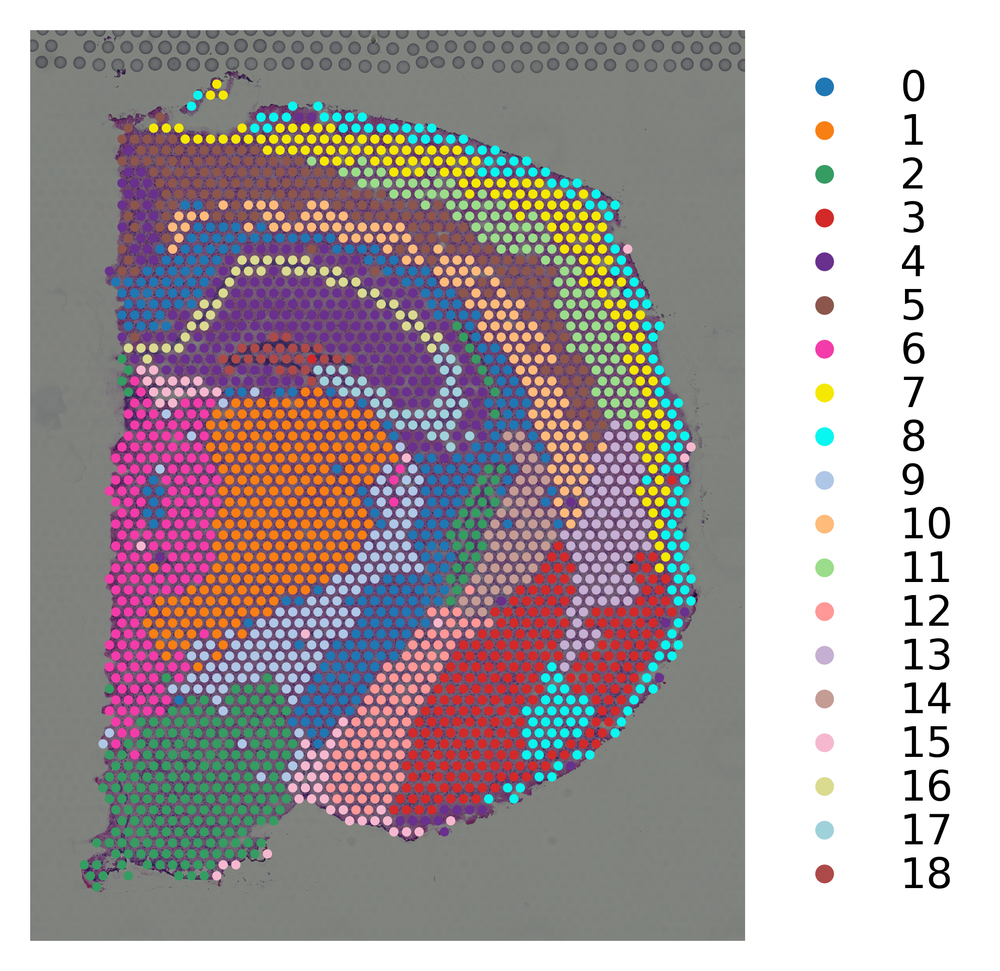

In [6]:

# louvain clustering on stSME normalised data
st.pp.neighbors(Sample1_SME,n_neighbors=17,use_rep='X_pca')
st.tl.clustering.louvain(Sample1_SME, resolution=1.20)
st.pl.cluster_plot(Sample1_SME,use_label="louvain")

In [28]:
Sample1_SME.obs["louvain"].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18'],
      dtype='object')

In [8]:
pd.Categorical(Sample1_SME.obs["louvain"].replace({"8": "18", "18": "8"}), 
               categories=Sample1_SME.obs["louvain"].cat.categories)

['3', '18', '6', '18', '6', ..., '0', '2', '2', '6', '7']
Length: 2702
Categories (19, object): ['0', '1', '2', '3', ..., '15', '16', '17', '18']

In [13]:
Sample1_SME.obs["louvain"] = pd.Categorical(Sample1_SME.obs["louvain"].replace({"7": "18", "18": "7"}), 
               categories=Sample1_SME.obs["louvain"].cat.categories)

In [15]:
Sample1_SME.obs["louvain"] = pd.Categorical(Sample1_SME.obs["louvain"].replace({"6": "16", "16": "6"}), 
               categories=Sample1_SME.obs["louvain"].cat.categories)

In [104]:
sample_cell = 0.20
sample_gene = 0.05

In [105]:
sample_cell

0.2

In [106]:
sample_gene

0.05

In [2]:
# iteration = 1
# for i in range(iteration):

#     n_cells = data.X.shape[0]
#     n_genes = data.X.shape[1]
#     indices_cells = np.random.choice(np.arange(n_cells), replace=False,
#                            size=int(n_cells * sample_cell))
#     indices_genes = np.random.choice(np.arange(n_genes), replace=False,
#                            size=int(n_genes * (1-sample_gene)))
#     test = data.X.toarray()
#     mask = np.zeros(test.shape)
#     mask[indices_cells] = 1
#     mask[:, indices_genes] = 0
#     mask = mask.astype(bool)
#     test[mask] = 0
    
#     data_SME = data.copy()
#     data_SME.X = test
#     # apply stSME to normalise log transformed data
#     st.spatial.SME.SME_normalize(data_SME, use_data="raw")
#     data_SME.X = data_SME.obsm['raw_SME_normalized']
#     st.pp.scale(data_SME)
#     st.em.run_pca(data_SME,n_comps=50)
#     # louvain clustering on stSME normalised data
#     st.pp.neighbors(data_SME,n_neighbors=17,use_rep='X_pca')
#     res = 0.7
#     for i in range(1000):
#         st.tl.clustering.louvain(data_SME, resolution=res)
#         n = len(list(set(data_SME.obs["louvain"])))
#         if n < n_cluster:
#             res = res + 0.01
#         elif n > n_cluster:
#             res = res - 0.01
#         elif n == n_cluster:
#             print(res)
#             break
#     st.pl.cluster_plot(data_SME,use_label="louvain")
    
#     data_o = data.copy()
#     data_o.X = test
#     st.pp.scale(data_o)
#     st.em.run_pca(data_o,n_comps=50)
#     # louvain clustering on stSME normalised data
#     st.pp.neighbors(data_o,n_neighbors=17,use_rep='X_pca')
#     res = 0.7
#     for i in range(1000):
#         st.tl.clustering.louvain(data_o, resolution=res)
#         n = len(list(set(data_o.obs["louvain"])))
#         if n < n_cluster:
#             res = res + 0.01
#         elif n > n_cluster:
#             res = res - 0.01
#         elif n == n_cluster:
#             print(res)
#             break
#     st.pl.cluster_plot(data_o,use_label="louvain")

In [108]:
data_SME.obs["louvain"] = pd.Categorical(data_SME.obs["louvain"].replace({"7": "18", "18": "7"}), 
               categories=data_SME.obs["louvain"].cat.categories)

In [109]:
data_SME.obs["louvain"] = pd.Categorical(data_SME.obs["louvain"].replace({"16": "6", "16": "6"}), 
               categories=data_SME.obs["louvain"].cat.categories)

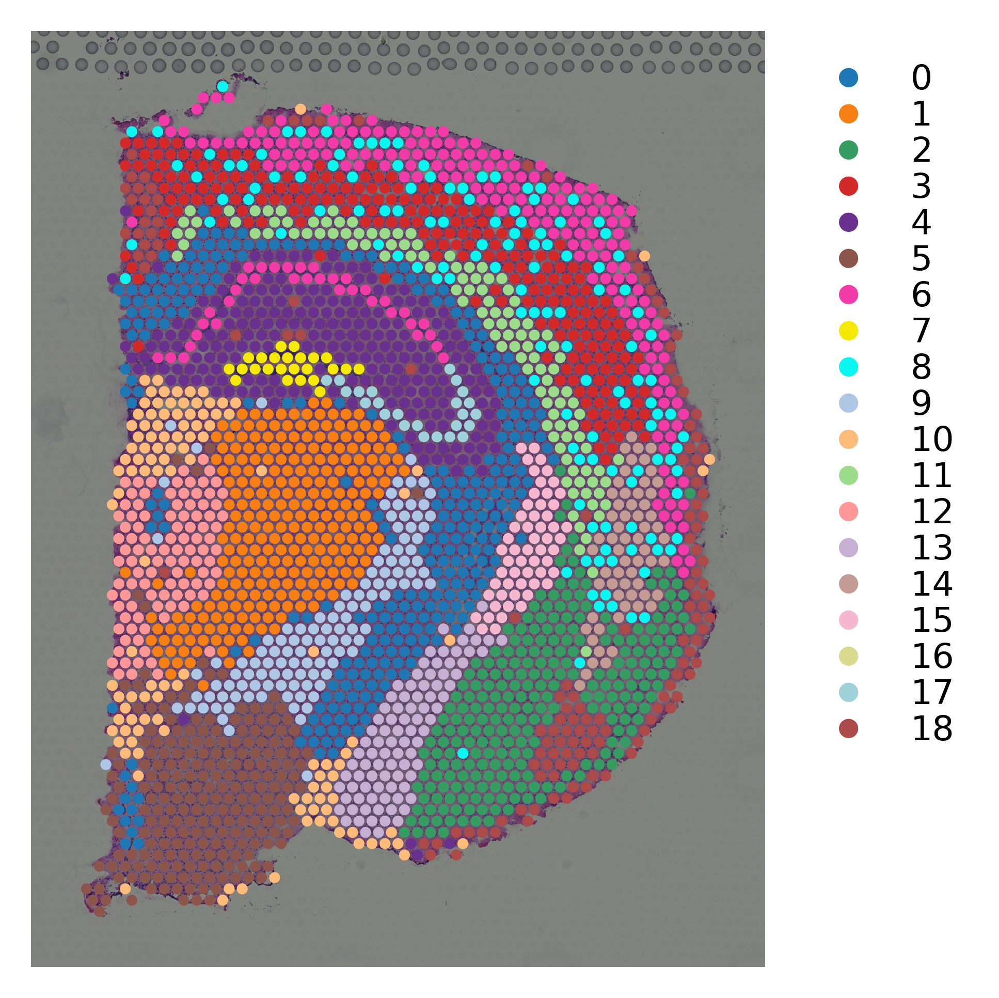

In [111]:
st.pl.cluster_plot(data_SME,use_label="louvain",output="./",name="stSME.pdf",dpi=300)

In [112]:
data_o.obs["louvain"] = pd.Categorical(data_o.obs["louvain"].replace({"7": "18", "18": "7"}), 
               categories=data_o.obs["louvain"].cat.categories)

In [113]:
data_o.obs["louvain"] = pd.Categorical(data_o.obs["louvain"].replace({"17": "14", "14": "17"}), 
               categories=data_o.obs["louvain"].cat.categories)

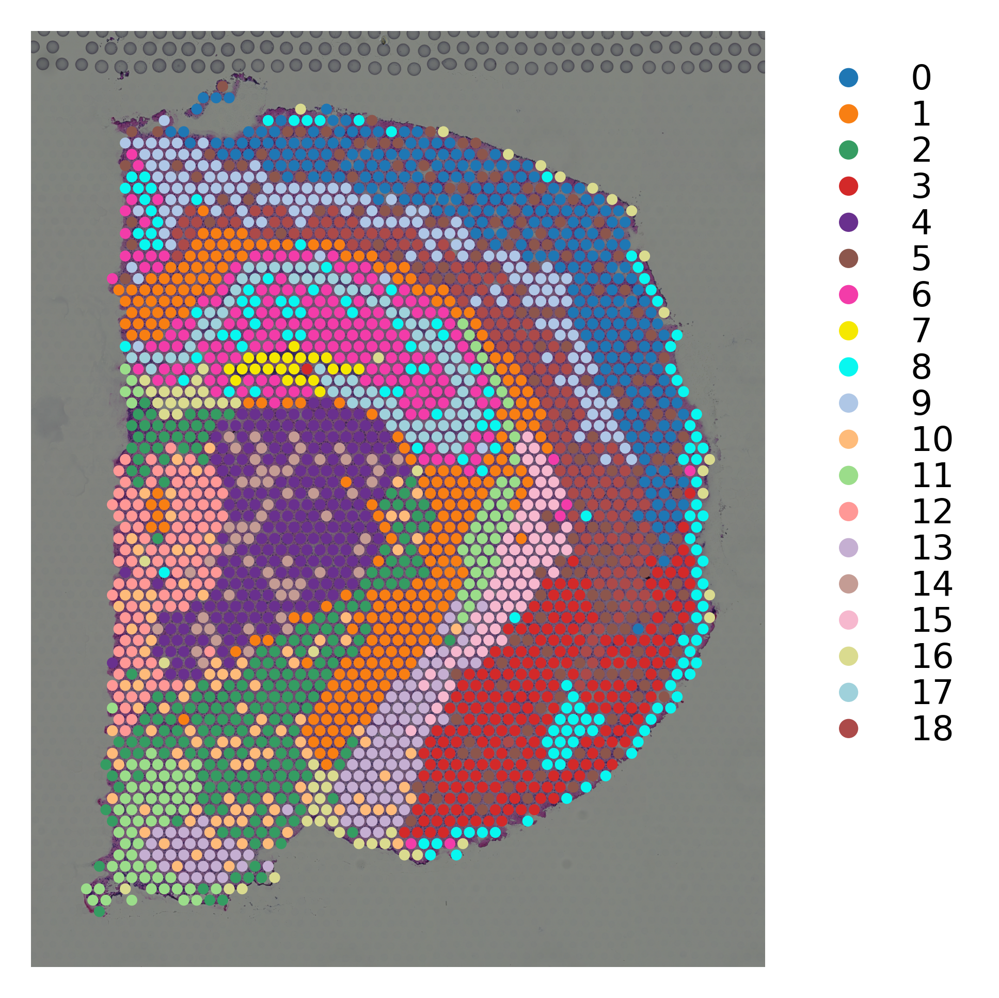

In [114]:
st.pl.cluster_plot(data_o,use_label="louvain",output="./",name="no_stSME.pdf",dpi=300)

In [59]:
?st.pl.cluster_plot

In [7]:
Sample1_SME_ = Sample1_SME.copy()

In [8]:
MASK1_PATH = BASE_PATH / "hippo_annotation/CA1.jpg"
MASK2_PATH = BASE_PATH / "hippo_annotation/CA2.jpg"
MASK3_PATH = BASE_PATH / "hippo_annotation/CA3.jpg"
MASK4_PATH = BASE_PATH / "hippo_annotation/DG.jpg"
MASK5_PATH = BASE_PATH / "hippo_annotation/Hippo.jpg"

In [9]:
st.add.add_mask(Sample1_SME_, MASK1_PATH, key="CA1")
st.add.add_mask(Sample1_SME_, MASK2_PATH, key="CA2")
st.add.add_mask(Sample1_SME_, MASK3_PATH, key="CA3")
st.add.add_mask(Sample1_SME_, MASK4_PATH, key="DG")
st.add.add_mask(Sample1_SME_, MASK5_PATH, key="Hippo")

Added tissue mask to the object!
Added tissue mask to the object!
Added tissue mask to the object!
Added tissue mask to the object!
Added tissue mask to the object!


In [10]:
st.add.apply_mask(Sample1_SME_)

Mask annotation for spots added to `adata.obs["mask_annotation"]`
Mask annotation for H&E image added to `adata.uns["mask_annotation"]`


In [18]:
Sample1_SME_hippo = Sample1_SME_[Sample1_SME_.obs["mask_annotation"] != "unassigned"].copy()
Sample1_SME_hippo_ = Sample1_SME_hippo[Sample1_SME_hippo.obs.query("`louvain` in ['4','16','17','18']").index].copy()

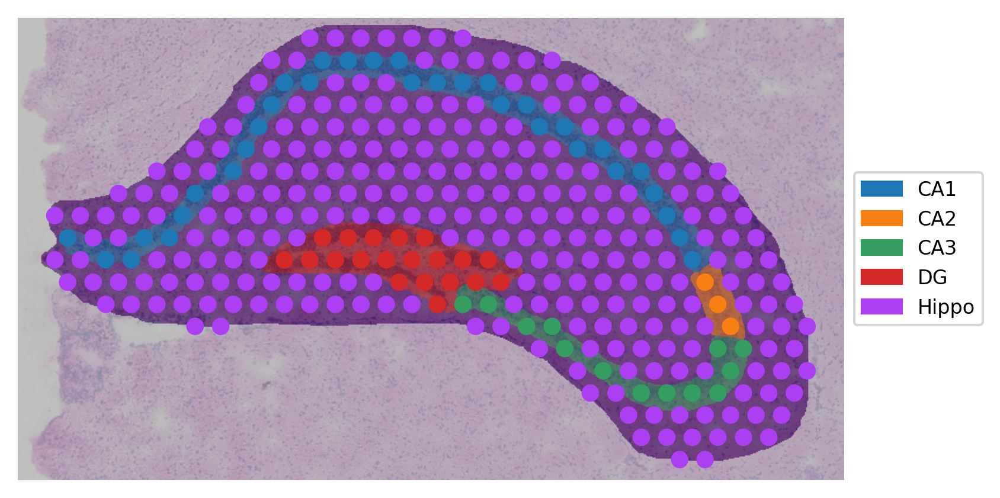

In [19]:
st.pl.plot_mask(Sample1_SME_hippo, spot_size=50)

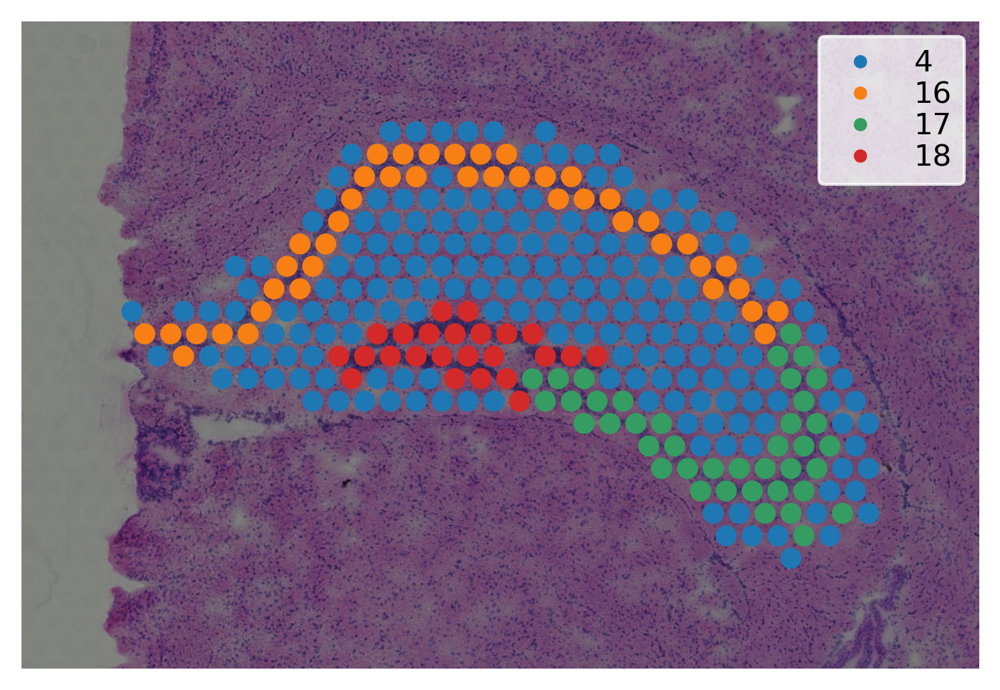

In [37]:
st.pl.cluster_plot(Sample1_SME_hippo_ ,use_label="louvain", size=50)

In [12]:
import pandas as pd
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score, silhouette_score, \
                            homogeneity_completeness_v_measure
from sklearn.metrics.cluster import contingency_matrix
from sklearn.preprocessing import LabelEncoder
import numpy as np
import scanpy


def purity_score(y_true, y_pred):
    # compute contingency matrix (also called confusion matrix)
    cm = contingency_matrix(y_true, y_pred)
    # return purity
    return np.sum(np.amax(cm, axis=0)) / np.sum(cm)


def calculate_clustering_matrix(pred, gt, sample, methods_):
    df = pd.DataFrame(columns=['Sample', 'Score', 'PCA_or_UMAP', 'Method', "Score_name"])
    
    pca_ari = adjusted_rand_score(pred, gt)
    df = df.append(pd.Series([sample, pca_ari, "pca", methods_, "Adjusted_Rand_Score"],
                             index=['Sample', 'Score', 'PCA_or_UMAP', 'Method', "Score_name"]), ignore_index=True)
   
    pca_nmi = normalized_mutual_info_score(pred, gt)
    df = df.append(pd.Series([sample, pca_nmi, "pca", methods_, "Normalized_Mutual_Info_Score"],
                             index=['Sample', 'Score', 'PCA_or_UMAP', 'Method', "Score_name"]), ignore_index=True)
    
    pca_purity = purity_score(pred, gt)
    df = df.append(pd.Series([sample, pca_purity, "pca", methods_, "Purity_Score"],
                             index=['Sample', 'Score', 'PCA_or_UMAP', 'Method', "Score_name"]), ignore_index=True)
    
    pca_homogeneity, pca_completeness, pca_v_measure = homogeneity_completeness_v_measure(pred, gt)
    
    df = df.append(pd.Series([sample, pca_homogeneity, "pca", methods_, "Homogeneity_Score"],
                             index=['Sample', 'Score', 'PCA_or_UMAP', 'Method', "Score_name"]), ignore_index=True)

    
    df = df.append(pd.Series([sample, pca_completeness, "pca", methods_, "Completeness_Score"],
                             index=['Sample', 'Score', 'PCA_or_UMAP', 'Method', "Score_name"]), ignore_index=True)
 
    df = df.append(pd.Series([sample, pca_v_measure, "pca", methods_, "V_Measure_Score"],
                             index=['Sample', 'Score', 'PCA_or_UMAP', 'Method', "Score_name"]), ignore_index=True)
    return df

In [132]:
df_1 = calculate_clustering_matrix(Sample1_SME_hippo_.obs["louvain"], 
                                   Sample1_SME_hippo_.obs["mask_annotation_code"], SAMPLE, "stSME")

In [133]:
df_1

,Sample,Score,PCA_or_UMAP,Method,Score_name
0,Sampel1,0.583615,pca,stSME,Adjusted_Rand_Score
1,Sampel1,0.526707,pca,stSME,Normalized_Mutual_Info_Score
2,Sampel1,0.848993,pca,stSME,Purity_Score
3,Sampel1,0.467060,pca,stSME,Homogeneity_Score
4,Sampel1,0.603820,pca,stSME,Completeness_Score
5,Sampel1,0.526707,pca,stSME,V_Measure_Score


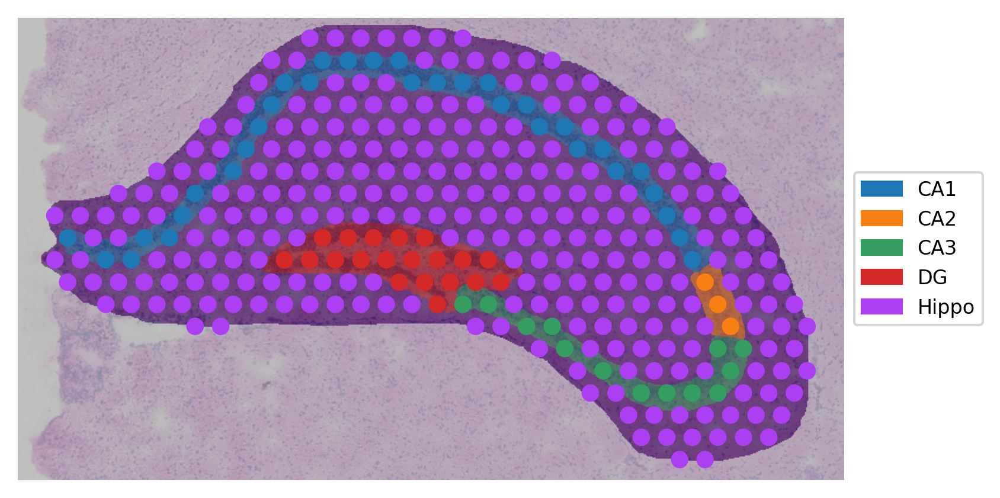

In [134]:
st.pl.plot_mask(Sample1_SME_hippo, spot_size=50)

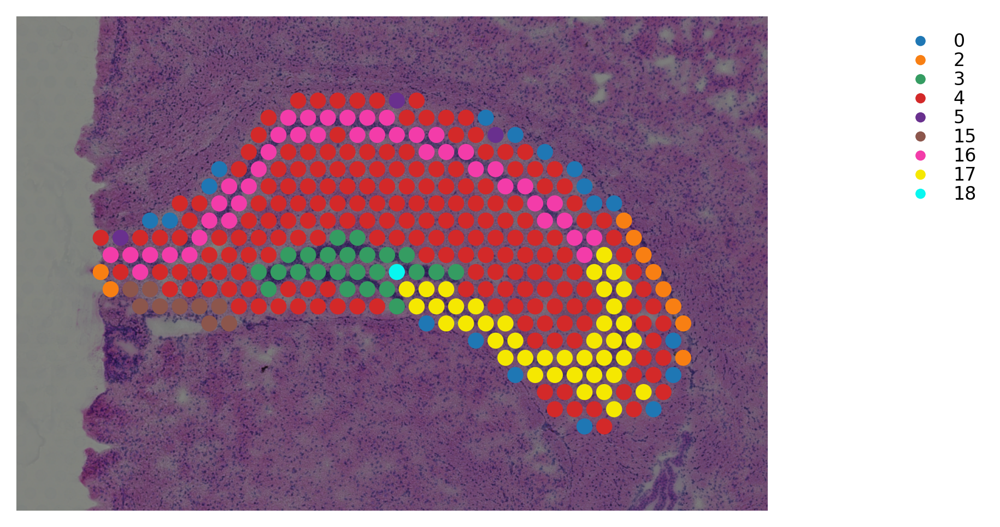

In [77]:
st.pl.cluster_plot(Sample1_SME_hippo,use_label="louvain", spot_size=50)

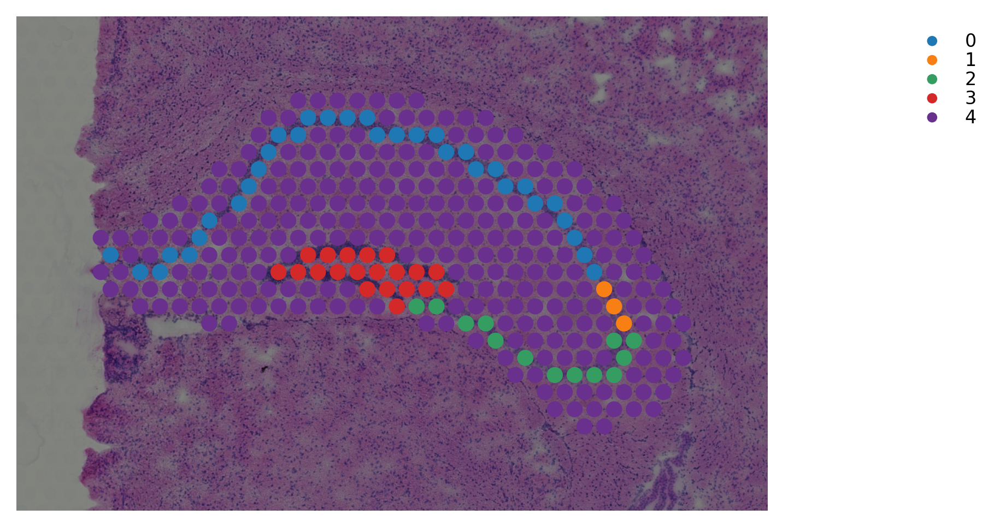

In [78]:
st.pl.cluster_plot(Sample1_SME_hippo,use_label="mask_annotation_code", spot_size=50)

In [13]:
def reform_cluster(adata, name, cls, gc, clo):
    adata.obs["{}_{}".format(clo,name)] = 0
    adata.obs["{}_{}".format(clo,name)][adata.obs[clo].astype(str) ==str(cls)] = 1
    adata.obs["gc_{}".format(name)] = 0 
    adata.obs["gc_{}".format(name)][adata.obs["mask_annotation_code"] == gc] = 1

In [138]:
reform_cluster(Sample1_SME_hippo, "CA1", 16, 0, "louvain")
reform_cluster(Sample1_SME_hippo, "CA2", 17, 1, "louvain")
reform_cluster(Sample1_SME_hippo, "CA3", 17, 2, "louvain")
reform_cluster(Sample1_SME_hippo, "DG", 18, 3, "louvain")
reform_cluster(Sample1_SME_hippo, "Hippo", 4, 4, "louvain")

<ipython-input-135-57f0b62c42a3>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["{}_{}".format(clo,name)][adata.obs[clo].astype(str) ==str(cls)] = 1
<ipython-input-135-57f0b62c42a3>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["gc_{}".format(name)][adata.obs["mask_annotation_code"] == gc] = 1
<ipython-input-135-57f0b62c42a3>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["{}_{}".format(clo,name)][a

In [14]:
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score

In [140]:
for name in ["CA1", "CA2", "CA3", "DG", "Hippo"]:
    acc = accuracy_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["louvain_{}".format(name)], normalize=True, sample_weight=None)
    print("{} acc: {}".format(name, acc))

CA1 acc: 0.9587020648967551
CA2 acc: 0.8908554572271387
CA3 acc: 0.9203539823008849
DG acc: 0.9646017699115044
Hippo acc: 0.7610619469026548


In [143]:
for name in ["CA1", "CA2", "CA3", "DG", "Hippo"]:
    f1s = f1_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["louvain_{}".format(name)])
    print("{} f1: {}".format(name, f1s))

CA1 acc: 0.8157894736842105
CA2 acc: 0.13953488372093023
CA3 acc: 0.4905660377358491
DG acc: 0.7272727272727272
Hippo acc: 0.824295010845987


In [155]:
for name in ["CA1", "CA2", "CA3", "DG", "Hippo"]:
    aucs = roc_auc_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["louvain_{}".format(name)])
    print("{} auc: {}".format(name, aucs))

CA1 auc: 0.9500891265597148
CA2 auc: 0.9449404761904762
CA3 auc: 0.9585889570552147
DG auc: 0.887460815047022
Hippo auc: 0.8446054750402577


In [ ]:
Sample1_SME_hippo

In [21]:
seurat_path = Path("/home/uqxtan9/90days/stlearn_revision2/Seurat_results/mouse_brain_coronal_clusters.csv")
spata_path = Path("/home/uqxtan9/90days/stlearn_revision2/Spata_results/mouse_brain_coronal_clusters.csv")
giotto_path = Path("/home/uqxtan9/90days/stlearn_revision2/Giotto_results/mouse_brain_coronal_clusters.csv")
bayes_path = Path("/home/uqxtan9/Q1851/Xiao/Working_project/stlearn_revision_v/BayesSpace_results/mouse_brain_coronal_clustering_label.csv")


In [16]:
seurat_path = Path("/home/uqxtan9/90days/stlearn_revision2/Seurat/mouse_brain_coronal_clusters_19.csv")
spata_path = Path("/home/uqxtan9/90days/stlearn_revision2/Spata/mouse_brain_coronal_clusters_19.csv")
giotto_path = Path("/home/uqxtan9/90days/stlearn_revision2/Giotto/mouse_brain_coronal_clusters_19.csv")
bayes_path = Path("/home/uqxtan9/90days/stlearn_revision2/BayesSpace_results/mouse_brain_coronal_clustering_label.csv")



In [148]:
seurat_df = pd.read_csv(seurat_path, index_col=0)
seurat_df = seurat_df.reindex(Sample1_SME_hippo.obs_names)
Sample1_SME_hippo.obs["seurat"] = seurat_df["seurat_clusters"]

In [149]:
reform_cluster(Sample1_SME_hippo, "CA1", 17, 0,"seurat")
# reform_cluster(Sample1_SME_hippo, "CA2", 17, 1,"seurat")
# reform_cluster(Sample1_SME_hippo, "CA3", 18, 2,"seurat")
reform_cluster(Sample1_SME_hippo, "DG", 18, 3,"seurat")
reform_cluster(Sample1_SME_hippo, "Hippo", 2, 4,"seurat")

<ipython-input-135-57f0b62c42a3>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["{}_{}".format(clo,name)][adata.obs[clo].astype(str) ==str(cls)] = 1
<ipython-input-135-57f0b62c42a3>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["gc_{}".format(name)][adata.obs["mask_annotation_code"] == gc] = 1
<ipython-input-135-57f0b62c42a3>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["{}_{}".format(clo,name)][a

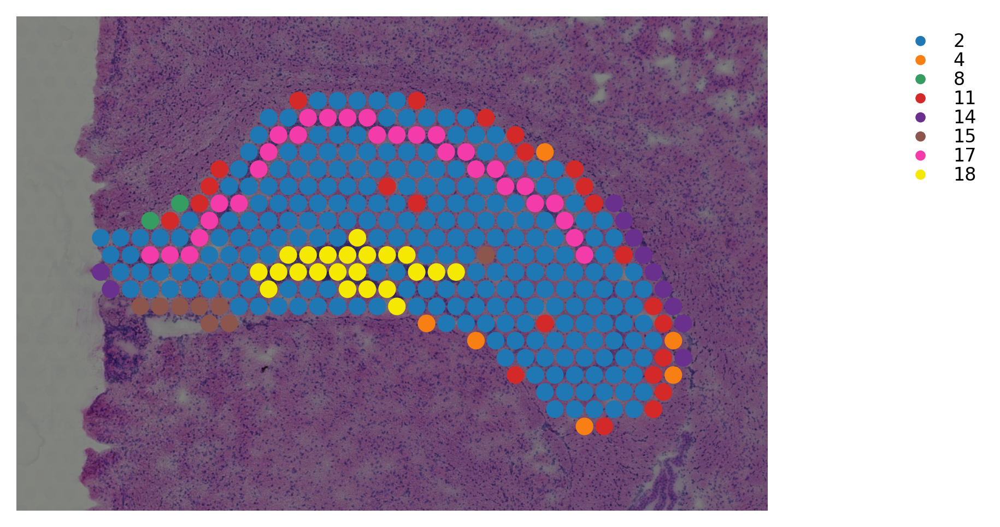

In [150]:
st.pl.cluster_plot(Sample1_SME_hippo,use_label="seurat",spot_size=60)

In [151]:
for name in ["CA1", 
#              "CA2", 
#              "CA3", 
             "DG", 
             "Hippo"]:
    acc = accuracy_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["seurat_{}".format(name)], normalize=True, sample_weight=None)
    print("{} acc: {}".format(name, acc))

CA1 acc: 0.9793510324483776
DG acc: 0.9646017699115044
Hippo acc: 0.7463126843657817


In [154]:
for name in ["CA1", 
#              "CA2", 
#              "CA3", 
             "DG", 
             "Hippo"]:
    aucs = roc_auc_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["seurat_{}".format(name)])
    print("{} auc: {}".format(name, aucs))

CA1 auc: 0.9209744503862152
DG auc: 0.8640282131661442
Hippo auc: 0.7004830917874396


In [157]:
spata_df = pd.read_csv(spata_path, index_col=0)
spata_df.index = spata_df["barcodes"].str.split("_").str.get(0)
spata_df = spata_df.reindex(Sample1_SME_hippo.obs_names)
Sample1_SME_hippo.obs["spata"] = spata_df["cluster_louvain_PCA_k9"]

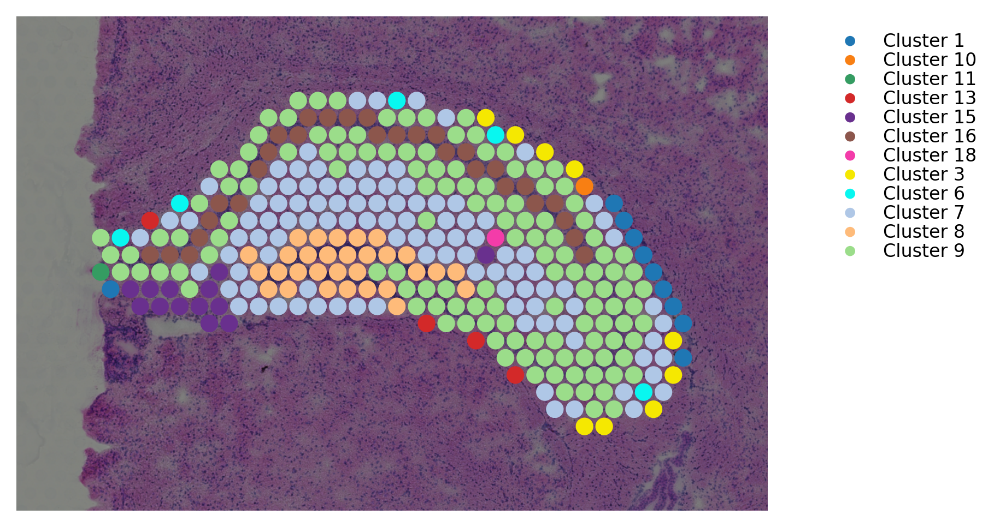

In [158]:
st.pl.cluster_plot(Sample1_SME_hippo,use_label="spata",spot_size=60)

In [159]:
reform_cluster(Sample1_SME_hippo, "CA1", "Cluster 16", 0, "spata")
# reform_cluster(Sample1_SME_hippo, "CA2", 17, 1, "spata")
reform_cluster(Sample1_SME_hippo, "CA3", "Cluster 9", 2, "spata")
reform_cluster(Sample1_SME_hippo, "DG", "Cluster 8", 3, "spata")
reform_cluster(Sample1_SME_hippo, "Hippo", "Cluster 7", 4, "spata")

<ipython-input-135-57f0b62c42a3>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["{}_{}".format(clo,name)][adata.obs[clo].astype(str) ==str(cls)] = 1
<ipython-input-135-57f0b62c42a3>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["gc_{}".format(name)][adata.obs["mask_annotation_code"] == gc] = 1
<ipython-input-135-57f0b62c42a3>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["{}_{}".format(clo,name)][a

In [160]:
for name in ["CA1", 
#              "CA2", 
             "CA3", 
             "DG", 
             "Hippo"]:
    acc = accuracy_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["spata_{}".format(name)], normalize=True, sample_weight=None)
    print("{} acc: {}".format(name, acc))

CA1 acc: 0.9793510324483776
CA3 acc: 0.6548672566371682
DG acc: 0.9410029498525073
Hippo acc: 0.5132743362831859


In [161]:
for name in ["CA1", 
#              "CA2", 
             "CA3", 
             "DG", 
             "Hippo"]:
    aucs = roc_auc_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["spata_{}".format(name)])
    print("{} aucs: {}".format(name, aucs))

CA1 aucs: 0.9209744503862152
CA3 aucs: 0.8205521472392638
DG aucs: 0.8514890282131662
Hippo aucs: 0.6944444444444444


In [162]:
giotto_df = pd.read_csv(giotto_path, index_col=1)
# giotto_df.index = giotto_df["barcodes"].str.split("_").str.get(0)
giotto_df = giotto_df.reindex(Sample1_SME_hippo.obs_names)
Sample1_SME_hippo.obs["giotto"] = giotto_df["leiden_clus"]

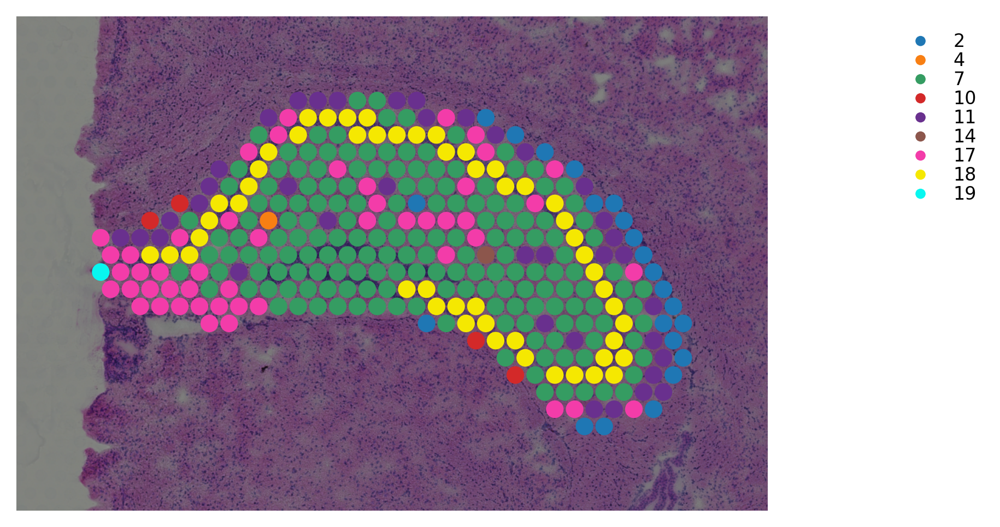

In [163]:
st.pl.cluster_plot(Sample1_SME_hippo,use_label="giotto",spot_size=60)

In [164]:
reform_cluster(Sample1_SME_hippo, "CA1", "18", 0, "giotto")
# reform_cluster(Sample1_SME_hippo, "CA2", 17, 1, "giotto")
# reform_cluster(Sample1_SME_hippo, "CA3", "Cluster 3", 2, "giotto")
# reform_cluster(Sample1_SME_hippo, "DG", 9, 3, "giotto")
reform_cluster(Sample1_SME_hippo, "Hippo", "7", 4, "giotto")

<ipython-input-135-57f0b62c42a3>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["{}_{}".format(clo,name)][adata.obs[clo].astype(str) ==str(cls)] = 1
<ipython-input-135-57f0b62c42a3>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["gc_{}".format(name)][adata.obs["mask_annotation_code"] == gc] = 1
<ipython-input-135-57f0b62c42a3>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["{}_{}".format(clo,name)][a

In [165]:
for name in ["CA1", 
#              "CA2", 
#              "CA3", 
#              "DG", 
             "Hippo"]:
    acc = accuracy_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["giotto_{}".format(name)], normalize=True, sample_weight=None)
    print("{} acc: {}".format(name, acc))

CA1 acc: 0.9174041297935103
Hippo acc: 0.5958702064896755


In [166]:
for name in ["CA1", 
#              "CA2", 
#              "CA3", 
#              "DG", 
             "Hippo"]:
    aucs = roc_auc_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["giotto_{}".format(name)])
    print("{} aucs: {}".format(name, aucs))

CA1 aucs: 0.8866607248960191
Hippo aucs: 0.6384057971014493


In [27]:
bayes_df = pd.read_csv(bayes_path, index_col=0)
bayes_df = bayes_df.reindex(Sample1_SME_hippo.obs_names)
Sample1_SME_hippo.obs["bayes"] = pd.Categorical(bayes_df["spatial.cluster"].astype(str))

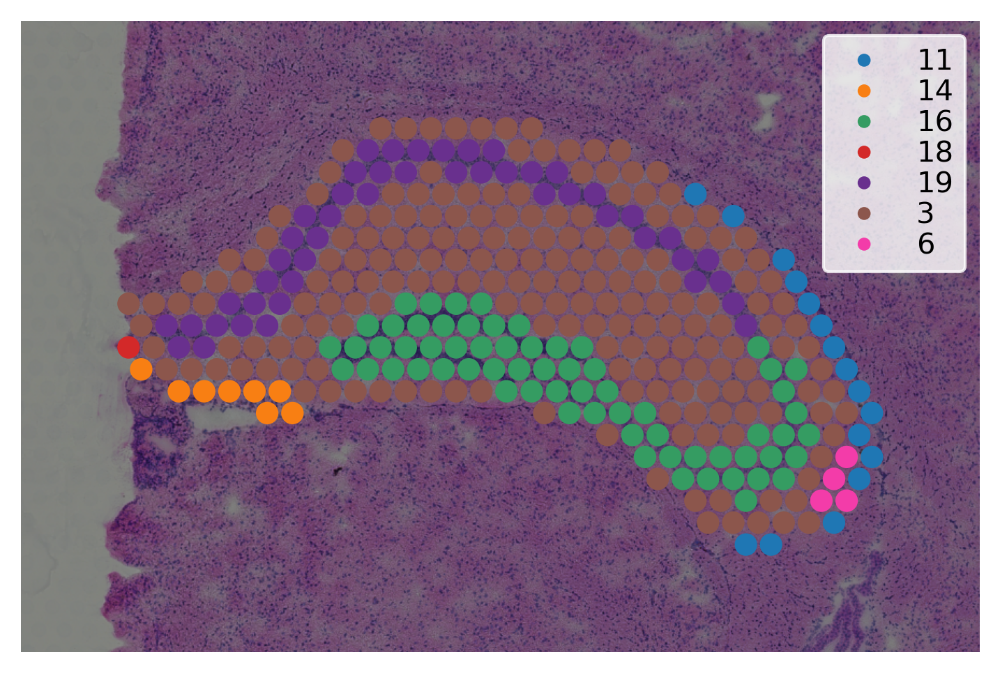

In [28]:
st.pl.cluster_plot(Sample1_SME_hippo,use_label="bayes",size=60)

In [29]:
reform_cluster(Sample1_SME_hippo, "CA1", "19", 0, "bayes")
# reform_cluster(Sample1_SME_hippo, "CA2", 17, 1, "giotto")
reform_cluster(Sample1_SME_hippo, "CA3", "16", 2, "bayes")
# reform_cluster(Sample1_SME_hippo, "DG", "16", 3, "bayes")
reform_cluster(Sample1_SME_hippo, "Hippo", "3", 4, "bayes")

/scratch/tmp/pbs.452298.delta2/ipykernel_24328/549355289.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["{}_{}".format(clo,name)][adata.obs[clo].astype(str) ==str(cls)] = 1
/scratch/tmp/pbs.452298.delta2/ipykernel_24328/549355289.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["gc_{}".format(name)][adata.obs["mask_annotation_code"] == gc] = 1


In [30]:
for name in ["CA1", 
#              "CA2", 
             "CA3", 
#              "DG", 
             "Hippo"]:
    acc = accuracy_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["bayes_{}".format(name)], normalize=True, sample_weight=None)
    print("{} acc: {}".format(name, acc))

CA1 acc: 0.9469026548672567
CA3 acc: 0.8466076696165191
Hippo acc: 0.7817109144542773


In [171]:
for name in ["CA1", 
#              "CA2", 
#              "CA3", 
             "DG", 
             "Hippo"]:
    aucs = roc_auc_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["bayes_{}".format(name)])
    print("{} aucs: {}".format(name, aucs))

CA1 aucs: 0.9435531788472965
DG aucs: 0.9294670846394985
Hippo aucs: 0.8575684380032206


In [40]:
spaGCN_path = Path("/home/uqxtan9/Q1851/Xiao/Working_project/stlearn_revision2/spaGCN/mouse_brain_10x_results_obs.csv")

In [55]:
spaGCN_df = pd.read_csv(spaGCN_path, index_col=0)
spaGCN_df = spaGCN_df.reindex(Sample1_SME_hippo.obs_names)
Sample1_SME_hippo.obs["spaGCN"] = pd.Categorical(spaGCN_df["refined_pred"].astype(str))

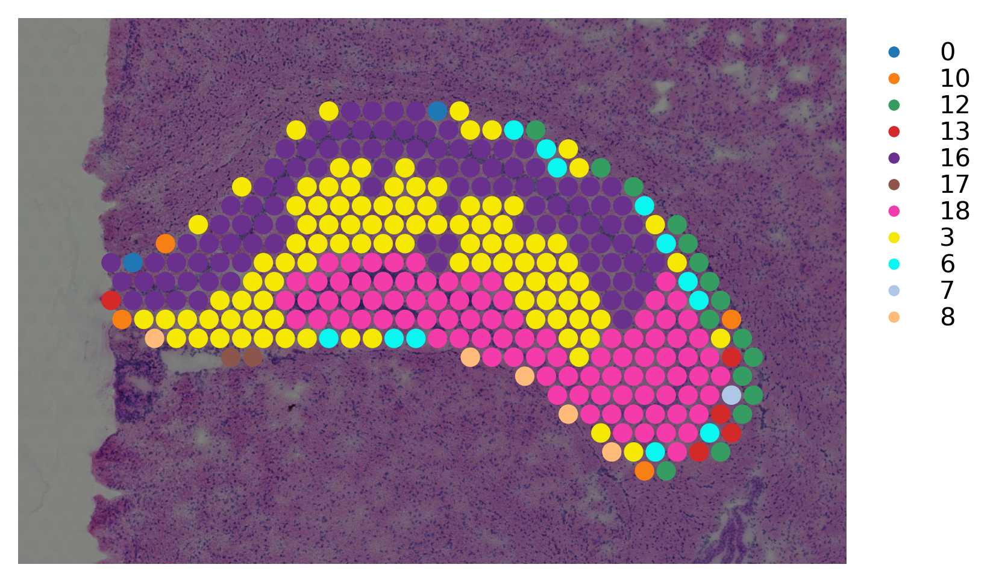

In [56]:
st.pl.cluster_plot(Sample1_SME_hippo,use_label="spaGCN",size=60)

In [59]:
reform_cluster(Sample1_SME_hippo, "CA1", "16", 0, "spaGCN")
# reform_cluster(Sample1_SME_hippo, "CA2", 17, 1, "spaGCN")
reform_cluster(Sample1_SME_hippo, "CA3", "18", 2, "spaGCN")
# reform_cluster(Sample1_SME_hippo, "DG", "16", 3, "spaGCN")
reform_cluster(Sample1_SME_hippo, "Hippo", "3", 4, "spaGCN")

/scratch/tmp/pbs.446947.delta2/ipykernel_32383/549355289.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["{}_{}".format(clo,name)][adata.obs[clo].astype(str) ==str(cls)] = 1
/scratch/tmp/pbs.446947.delta2/ipykernel_32383/549355289.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["gc_{}".format(name)][adata.obs["mask_annotation_code"] == gc] = 1


In [64]:
for name in ["CA1", 
#              "CA2", 
             "CA3", 
#              "DG", 
             "Hippo"]:
    acc = accuracy_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["spaGCN_{}".format(name)], normalize=True, sample_weight=None)
    print("{} acc: {}".format(name, acc))

CA1 acc: 0.7935103244837758
CA3 acc: 0.7669616519174042
Hippo acc: 0.49557522123893805


In [66]:
for name in ["CA1", 
#              "CA2", 
             "CA3", 
#              "DG", 
             "Hippo"]:
    aucs = roc_auc_score(Sample1_SME_hippo.obs["gc_{}".format(name)], 
                         Sample1_SME_hippo.obs["spaGCN_{}".format(name)])
    print("{} aucs: {}".format(name, aucs))

CA1 aucs: 0.8721033868092692
CA3 aucs: 0.8788343558282209
Hippo aucs: 0.6833333333333333


In [1]:
# data = Sample1.copy()
# data_SME = data.copy()
# # apply stSME to normalise log transformed data
# st.spatial.SME.SME_normalize(data_SME, use_data="raw")
# data_SME.X = data_SME.obsm['raw_SME_normalized']
# st.pp.scale(data_SME)
# st.em.run_pca(data_SME,n_comps=50)

# # louvain clustering on stSME normalised data
# st.pp.neighbors(data_SME,n_neighbors=17,use_rep='X_pca')
# st.tl.clustering.louvain(data_SME, resolution=1.2)


# gt_sme = data_SME.obs["louvain"]

# data_o = data.copy()
# st.pp.scale(data_o)
# st.em.run_pca(data_o,n_comps=50)

# # louvain clustering on stSME normalised data
# st.pp.neighbors(data_o,n_neighbors=17,use_rep='X_pca')
# st.tl.clustering.louvain(data_o, resolution=1.4)

# gt_nosme = data_o.obs["louvain"]

# sample_cell_list = [i*0.05 for i in range(6)]
# sample_gene = [i*0.05 for i in range(6)]
# combine = [(i,j) for i in sample_cell_list for j in sample_gene]

# df = pd.DataFrame()
# n_cluster = 19
# sample_cell = combine[4][0]
# sample_gene = combine[4][1]